<center><h1>Deep Learning for Brain Tumour Detection</h1></center>


## Table of contents -
* [1. Introduction](#Introduction)
   * [1.1 Role of Deep Learning in Healthcare](#role)
   * [1.2 Aims](#aim)
* [2. Data Collection and Pre-processing](#Collection)
   * [2.1 Data Augmentation](#aug)
* [3. Baseline model](#Model)
* [4. U-Net Image Segmentation for detecting brain tumor](#net)
* [5. Transfer learning VGG16](#trans)
* [6. Fine-tuning VGG16](#fine)
* [7. Final Evaluation](#eva)
* [8. Comparing results of baseline CNN and fine-tuned VGG16 model](#com)
* [9. Documentation and Reporting of findings](#doc)

### 1.Introduction<a class="anchor" id="Introduction"></a>

In recent years, advancements in deep learning and medical imaging technology have transformed the landscape of healthcare, particularly in the detection and diagnosis of complex diseases. This project focuses on harnessing these technologies to develop a robust deep learning model for the early detection of brain tumours using MRI scans. The primary objective is to enhance diagnostic accuracy, streamline clinical workflows, and ultimately improve patient outcomes.

<u>1.1 Role of Deep Learning in Healthcare -</u><a class="anchor" id="role"></a>

Deep learning has emerged as a game-changing technology in healthcare, offering unparalleled capabilities in medical image analysis. By learning intricate patterns and features from vast amounts of data, deep learning models can detect abnormalities that are often imperceptible to the human eye. In the context of this project, the U-Net model, known for its effectiveness in biomedical image segmentation, is employed to precisely delineate brain tumour boundaries from MRI scans. Transfer learning, which leverages pre-trained models like VGG16 or ResNet50, helps in classification of brain tumors and reduces the need for extensive annotated data, making it more adaptable to real-world clinical settings.

<u>1.2 Aims -</u> <a class="anchor" id="aim"></a>

This project aims to develop a robust deep learning model for the accurate detection of brain tumors from MRI images. Leveraging methods such as transfer learning, u-net and fine-tuning, the project seeks to validate these techniques to achieve a highly accurate model. By applying advanced deep learning techniques, the project aims to enhance diagnostic precision and effectiveness in medical imaging. Ultimately, the goal is to enable early diagnosis and personalized treatment plans through automated image analysis, thereby improving patient outcomes in clinical settings.

<u>Setting up the Environment and importing the required libraries</u>

In [3]:
import numpy as np
import pandas as pd
from tqdm import tqdm
import cv2
import os
import shutil
import random
import itertools
import imutils
import sys
import warnings #
import math
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.models import Model, Sequential, load_model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Activation, Dropout, Flatten, Dense, Input, Lambda, Conv2DTranspose, concatenate
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import Adam

import seaborn as sns
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

from PIL import Image
from scipy import misc
from os import listdir
from os.path import isfile, join
from random import shuffle
from collections import Counter

from skimage.io import imread, imshow, imread_collection, concatenate_images
from skimage.transform import resize
from skimage.morphology import label

import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
from plotly import tools

init_notebook_mode(connected=True)

/Users/nikhitha/Library/Python/3.9/lib/python/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


### 2. Data Collection and pre-processing<a class="anchor" id="Collection"></a>

The dataset's images are organized into a single folder containing 'yes' and 'no' subfolders. Next, we will divide the data into training, validation, and testing directories.

In [4]:
IMG_PATH = './brain_tumor_dataset/'

# Seed for reproducibility
random.seed(42)

# Define percentages for splits
test_ratio = 0.15
val_ratio = 0.15
train_ratio = 1 - test_ratio - val_ratio

# Make directories for train, val, test splits if they don't exist
for split in ['TRAIN', 'VAL', 'TEST']:
    for CLASS in os.listdir(IMG_PATH):
        if not CLASS.startswith('.'):
            split_dir = f'{split}/{CLASS.upper()}'
            os.makedirs(split_dir, exist_ok=True)

# Split the data
for CLASS in os.listdir(IMG_PATH):
    if not CLASS.startswith('.'):
        # Get the list of image files and shuffle them
        image_files = os.listdir(IMG_PATH + CLASS)
        random.shuffle(image_files)
        IMG_NUM = len(image_files)

        # Calculate split indices
        test_split = int(test_ratio * IMG_NUM)
        val_split = int(val_ratio * IMG_NUM) + test_split

        for n, FILE_NAME in enumerate(image_files):
            img = IMG_PATH + CLASS + '/' + FILE_NAME
            if n < test_split:  # Assign to the test set
                shutil.copy(img, 'TEST/' + CLASS.upper() + '/' + FILE_NAME)
            elif n < val_split:  # Assign to the validation set
                shutil.copy(img, 'VAL/' + CLASS.upper() + '/' + FILE_NAME)
            else:  # Assign the rest to the training set
                shutil.copy(img, 'TRAIN/' + CLASS.upper() + '/' + FILE_NAME)

This code organizes the brain MRI image dataset into training, validation, and testing sets to facilitate machine learning model development. It begins by specifying the dataset's path and loops through each image class. For each class, it counts the images and copies them into their respective directories (TRAIN/, TEST/, VAL/). 

In [5]:
def load_data(dir_path, img_size=(100, 100)):
    # Load resized images as np.arrays to workspace
    X = []
    y = []
    i = 0
    labels = dict()
    
    # Iterate over the directories (classes)
    for path in tqdm(sorted(os.listdir(dir_path))):
        if not path.startswith('.'):
            labels[i] = path
            class_dir = os.path.join(dir_path, path)
            
            # Iterate over the images in the class directory
            for file in os.listdir(class_dir):
                if not file.startswith('.'):
                    img_path = os.path.join(class_dir, file)
                    img = cv2.imread(img_path)
                    
                    if img is not None:
                        # Resize the image to the specified size
                        img = cv2.resize(img, img_size)
                        X.append(img)
                        y.append(i)
                    else:
                        print(f"Warning: {img_path} could not be read.")
            i += 1

    X = np.array(X)
    y = np.array(y)
    print(f'{len(X)} images loaded from {dir_path} directory.')
    
    return X, y, labels

The load_data function is designed to load and preprocess image data from a given directory path. It takes two parameters: dir_path, which represents the path to the dataset, and img_size, which defines the target size to resize the images (default is set to (100, 100)).

The function starts by initializing empty lists X and y to store the images and their associated labels, respectively. The variable i serves as a counter for assigning class labels, while the labels dictionary links these numerical labels to their corresponding class names.

It loops through each subdirectory (path) in dir_path, ignoring any hidden folders. For every image in these directories, it reads the image using OpenCV (cv2.imread), resizes it to the specified size (img_size), and appends the image array (img) to X. The corresponding numerical label (i) for the current class is added to y.

Once all images are processed, the function converts X and y into numpy arrays for better performance and returns them along with the labels dictionary. Finally, it displays the total number of images loaded from the directory.

In [7]:
TRAIN_DIR = 'TRAIN/'
TEST_DIR = 'TEST/'
VAL_DIR = 'VAL/'
IMG_SIZE = (224,224)

# use predefined function to load the image data into workspace
X_train, y_train, labels = load_data(TRAIN_DIR, IMG_SIZE)
X_test, y_test, _ = load_data(TEST_DIR, IMG_SIZE)
X_val, y_val, _ = load_data(VAL_DIR, IMG_SIZE)

100%|█████████████████████████████████████████████| 3/3 [00:00<00:00, 11.54it/s]


241 images loaded from TRAIN/ directory.


100%|█████████████████████████████████████████████| 3/3 [00:00<00:00, 62.48it/s]


49 images loaded from TEST/ directory.


100%|█████████████████████████████████████████████| 3/3 [00:00<00:00, 73.56it/s]

49 images loaded from VAL/ directory.


Let's take a look at the distribution of classes among sets:

In [23]:
y = dict()
y[0] = []
y[1] = []
for set_name in (y_train, y_val, y_test):
    y[0].append(np.sum(set_name == 0))
    y[1].append(np.sum(set_name == 1))

trace0 = go.Bar(
    x=['Train Set', 'Validation Set', 'Test Set'],
    y=y[0],
    name='No',
    marker=dict(color='#33cc33'),
    opacity=0.7
)
trace1 = go.Bar(
    x=['Train Set', 'Validation Set', 'Test Set'],
    y=y[1],
    name='Yes',
    marker=dict(color='#ff3300'),
    opacity=0.7
)
data = [trace0, trace1]
layout = go.Layout(
    title='Count of classes in each set',
    xaxis={'title': 'Set'},
    yaxis={'title': 'Count'}
)
fig = go.Figure(data, layout)
iplot(fig)

Generates a bar plot that displays the distribution of tumor and non-tumor images across various dataset splits (Train Set, Validation Set, and Test Set). The purpose of this visualization is to highlight the class balance within each dataset split, which is critical for effectively training and evaluating the machine learning model. By visualizing the class distribution, it helps ensure that the model is trained on a well-represented mix of both tumor and non-tumor images. Additionally, it offers valuable insights into potential biases or challenges that could emerge during the training and validation process.

In [24]:
def plot_samples(X, y, labels_dict, n=50):

#Creates a gridplot for desired number of images (n) from the specified set

    for index in range(len(labels_dict)):
        imgs = X[np.argwhere(y == index)][:n]
        j = 10
        i = int(n/j)

        plt.figure(figsize=(15,6))
        c = 1
        for img in imgs:
            plt.subplot(i,j,c)
            plt.imshow(img[0])

            plt.xticks([])
            plt.yticks([])
            c += 1
        plt.suptitle('Tumor: {}'.format(labels_dict[index]))
        plt.show()

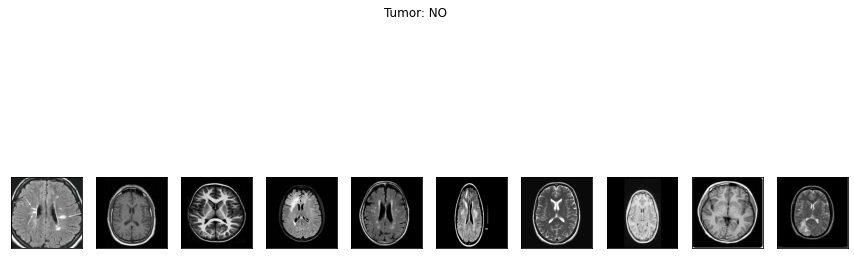

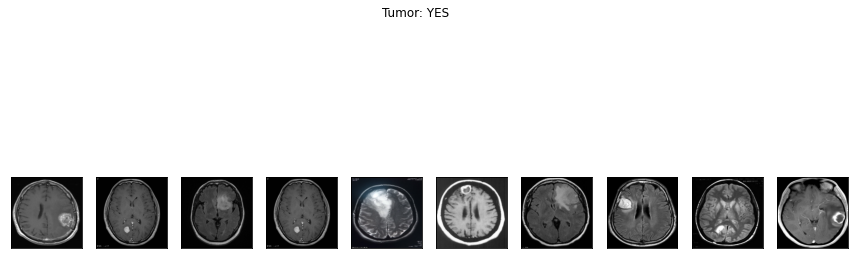

In [25]:
plot_samples(X_train, y_train, labels, 10)

As you can observe, the images vary in both width and height, with different sizes of black corners. Given that the VGG-16 input layer requires images of size (224, 224), some wide images may appear distorted after resizing. Below is a histogram of the ratio distributions (ratio = width/height) to better understand the aspect ratios of the images.

<u><b>Image preprocessing -</b></u>

The initial step in "normalization" involves cropping the brain region from the images. This can be accomplished using OpenCV, which helps to focus on the relevant area and remove unnecessary background, enhancing the effectiveness of further processing steps.

In [26]:
def crop_imgs(set_name, add_pixels_value=0):

    set_new = []
    for img in set_name:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        gray = cv2.GaussianBlur(gray, (5, 5), 0)

        # threshold the image, then perform a series of erosions +
        # dilations to remove any small regions of noise
        thresh = cv2.threshold(gray, 45, 255, cv2.THRESH_BINARY)[1]
        thresh = cv2.erode(thresh, None, iterations=2)
        thresh = cv2.dilate(thresh, None, iterations=2)

        # find contours in thresholded image, then grab the largest one
        cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        cnts = imutils.grab_contours(cnts)
        c = max(cnts, key=cv2.contourArea)

        # find the extreme points
        extLeft = tuple(c[c[:, :, 0].argmin()][0])
        extRight = tuple(c[c[:, :, 0].argmax()][0])
        extTop = tuple(c[c[:, :, 1].argmin()][0])
        extBot = tuple(c[c[:, :, 1].argmax()][0])

        ADD_PIXELS = add_pixels_value
        new_img = img[extTop[1]-ADD_PIXELS:extBot[1]+ADD_PIXELS, extLeft[0]-ADD_PIXELS:extRight[0]+ADD_PIXELS].copy()
        set_new.append(new_img)

    return np.array(set_new)

The crop_imgs function is designed to preprocess MRI images for brain tumor detection by isolating the region of interest. It begins by converting the RGB image to grayscale and applying a Gaussian blur, followed by thresholding to create a binary image. Next, it identifies the largest contour and extracts the extreme points to define a bounding box around the brain tumor area. Using these points, the function crops the original image, with an option to add extra pixels for padding. This preprocessing step minimizes noise and ensures that the model focuses on the most relevant parts of the image, enhancing the accuracy of tumor detection.

This function allows you to visualize how the images have been refined to emphasize the brain tumor region, which is essential for training an effective and precise detection model.

Let's examine how this function would operate on MRI scans to better understand the outcome. By applying the crop_imgs function, we can observe how it processes the images to crop out the brain tumor region. This will give us a clearer picture of how the preprocessing step enhances the focus on the area of interest, optimizing the scans for further analysis or model training.

In [27]:
img = cv2.imread('./brain_tumor_dataset/yes/Y108.jpg')
img = cv2.resize(
            img,
            dsize=IMG_SIZE,
            interpolation=cv2.INTER_CUBIC
        )
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
gray = cv2.GaussianBlur(gray, (5, 5), 0)

# threshold the image, then perform a series of erosions +
# dilations to remove any small regions of noise
thresh = cv2.threshold(gray, 45, 255, cv2.THRESH_BINARY)[1]
thresh = cv2.erode(thresh, None, iterations=2)
thresh = cv2.dilate(thresh, None, iterations=2)

# find contours in thresholded image, then grab the largest one
cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
c = max(cnts, key=cv2.contourArea)

# find the extreme points
extLeft = tuple(c[c[:, :, 0].argmin()][0])
extRight = tuple(c[c[:, :, 0].argmax()][0])
extTop = tuple(c[c[:, :, 1].argmin()][0])
extBot = tuple(c[c[:, :, 1].argmax()][0])

# add contour on the image
img_cnt = cv2.drawContours(img.copy(), [c], -1, (0, 255, 255), 4)

# add extreme points
img_pnt = cv2.circle(img_cnt.copy(), extLeft, 8, (0, 0, 255), -1)
img_pnt = cv2.circle(img_pnt, extRight, 8, (0, 255, 0), -1)
img_pnt = cv2.circle(img_pnt, extTop, 8, (255, 0, 0), -1)
img_pnt = cv2.circle(img_pnt, extBot, 8, (255, 255, 0), -1)

# crop
ADD_PIXELS = 0
new_img = img[extTop[1]-ADD_PIXELS:extBot[1]+ADD_PIXELS, extLeft[0]-ADD_PIXELS:extRight[0]+ADD_PIXELS].copy()

We first loaded an image, resized it, and converted it to grayscale. Next, we applied Gaussian blur and thresholding to generate a binary image. Afterward, contours were detected, and the largest contour was identified to determine extreme points such as the top, bottom, left, and right boundaries of the tumor. These extreme points were then marked on the image, and a region of interest (ROI) was cropped around the tumor based on these points.

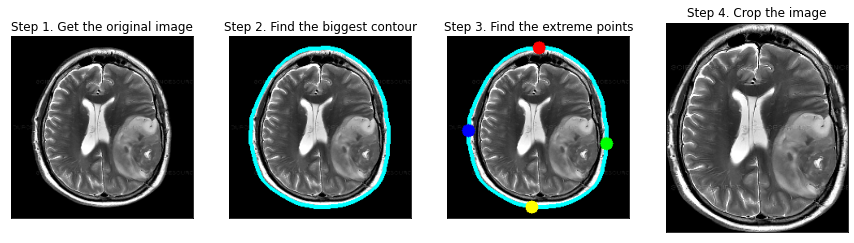

In [28]:
plt.figure(figsize=(15,6))
plt.subplot(141)
plt.imshow(img)
plt.xticks([])
plt.yticks([])
plt.title('Step 1. Get the original image')
plt.subplot(142)
plt.imshow(img_cnt)
plt.xticks([])
plt.yticks([])
plt.title('Step 2. Find the biggest contour')
plt.subplot(143)
plt.imshow(img_pnt)
plt.xticks([])
plt.yticks([])
plt.title('Step 3. Find the extreme points')
plt.subplot(144)
plt.imshow(new_img)
plt.xticks([])
plt.yticks([])
plt.title('Step 4. Crop the image')
plt.show()

Let's apply this process to each dataset split (training, validation, and test sets) to ensure that all images are consistently preprocessed by cropping the region of interest around the brain tumor. This will standardize the images and allow the model to focus on the relevant areas during training, validation, and testing.

In [29]:
X_train_crop = crop_imgs(set_name=X_train)
X_val_crop = crop_imgs(set_name=X_val)
X_test_crop = crop_imgs(set_name=X_test)

/var/folders/1x/lcz6lbkj70x5p6_2vnx0nh3h0000gn/T/ipykernel_31823/868353282.py:29: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



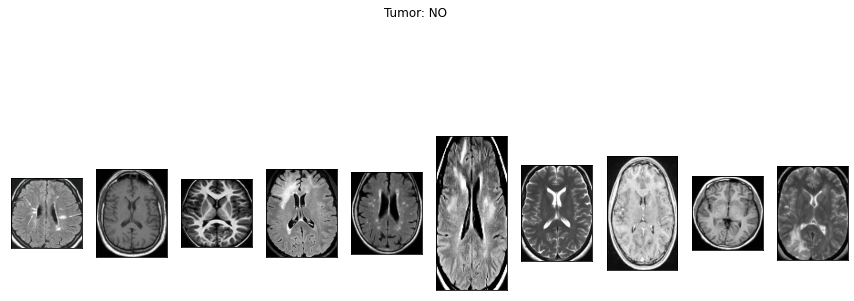

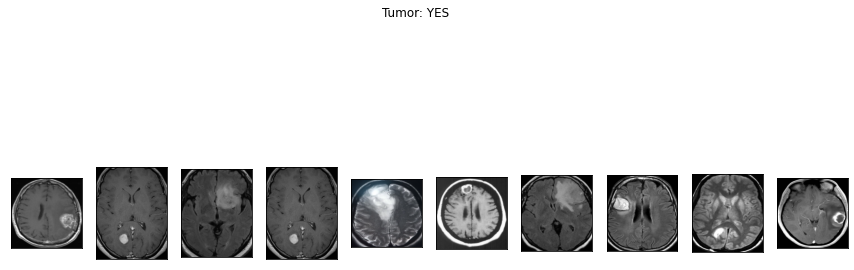

In [30]:
plot_samples(X_train_crop, y_train, labels, 10)

In [31]:
def save_new_images(x_set, y_set, folder_name):
    i = 0
    for (img, imclass) in zip(x_set, y_set):
        if imclass == 0:
            cv2.imwrite(folder_name+'NO/'+str(i)+'.jpg', img)
        else:
            cv2.imwrite(folder_name+'YES/'+str(i)+'.jpg', img)
        i += 1

In [32]:
# saving new images to the folder
!mkdir TRAIN_CROP TEST_CROP VAL_CROP TRAIN_CROP/YES TRAIN_CROP/NO TEST_CROP/YES TEST_CROP/NO VAL_CROP/YES VAL_CROP/NO

save_new_images(X_train_crop, y_train, folder_name='TRAIN_CROP/')
save_new_images(X_val_crop, y_val, folder_name='VAL_CROP/')
save_new_images(X_test_crop, y_test, folder_name='TEST_CROP/')

This function is responsible for organizing and saving the cropped MRI images into designated directories for the training, validation, and testing datasets (TRAIN_CROP, VAL_CROP, TEST_CROP). It ensures that the data is properly structured and ready for further processing and model training.

The subsequent step will involve resizing the images to the required dimensions of (224, 224) to match the input size for the model.

In [33]:
def preprocess_imgs(set_name, img_size):

# Resize and apply image preprocessing

    set_new = []
    for img in set_name:
        img = cv2.resize(
            img,
            dsize=img_size,
            interpolation=cv2.INTER_CUBIC
        )
        set_new.append(preprocess_input(img))
    return np.array(set_new)

In [34]:
X_train_prep = preprocess_imgs(set_name=X_train_crop, img_size=IMG_SIZE)
X_test_prep = preprocess_imgs(set_name=X_test_crop, img_size=IMG_SIZE)
X_val_prep = preprocess_imgs(set_name=X_val_crop, img_size=IMG_SIZE)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

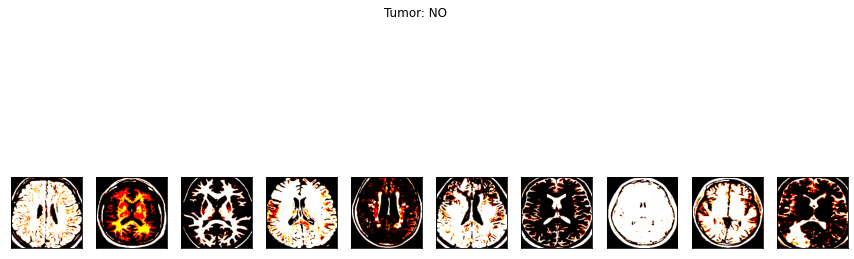

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

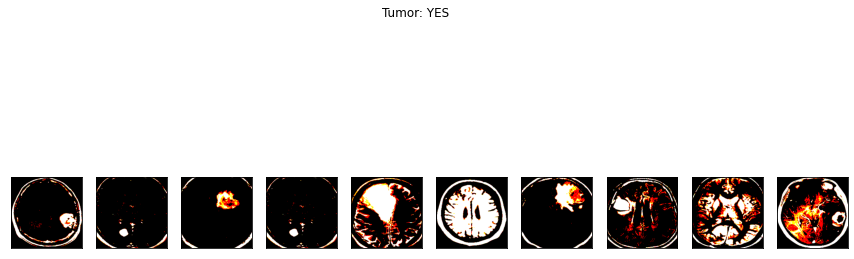

In [35]:
 plot_samples(X_train_prep, y_train, labels, 10)

The preprocess_imgs function resizes each image in the specified set_name to the desired img_size using cubic interpolation, followed by applying VGG-16 preprocessing. This step ensures that the images are standardized and formatted correctly for input into the VGG-16 model, which requires data in a specific structure. The function returns the preprocessed images as an array (set_new). Once the cropped MRI images (e.g., X_train_crop, X_test_crop, X_val_crop) have been processed, the function organizes and saves them into their respective directories (TRAIN_CROP, VAL_CROP, TEST_CROP) for easy access and further use in model training and evaluation.

### 2.1 Data Augmentation<a class="anchor" id="aug"></a>

Since my dataset was relatively small, I applied data augmentation techniques to expand the size of the training set. This approach enhanced the diversity of the data, helping to improve the model's performance by introducing variations such as rotations, shifts, and flips, which simulate a wider range of scenarios for the model to learn from.

In [36]:
# set the paramters we want to change randomly
demo_datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.05,
    height_shift_range=0.05,
    rescale=1./255,
    shear_range=0.05,
    brightness_range=[0.1, 1.5],
    horizontal_flip=True,
    vertical_flip=True
)

Data augmentation is a method used to artificially increase the size of a dataset by applying random transformations to the images. This helps reduce overfitting and allows the model to generalize more effectively to unseen data. In the context of medical imaging, this technique is especially valuable when working with small datasets. For this project, augmentation methods such as rotation, flipping, zooming, and brightness/contrast adjustments were applied to the training images. These transformations simulate various viewing conditions, enhancing the model's ability to handle differences in MRI image quality and improving its overall robustness.

In [38]:
x = X_train_crop[0]  
x = x.reshape((1,) + x.shape) 

# Create the 'preview' directory 
save_dir = 'preview'
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

i = 0
for batch in demo_datagen.flow(x, batch_size=1, save_to_dir='preview', save_prefix='aug_img', save_format='jpg'):
    i += 1
    if i > 20:
        break 

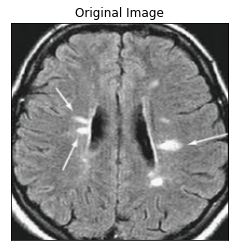

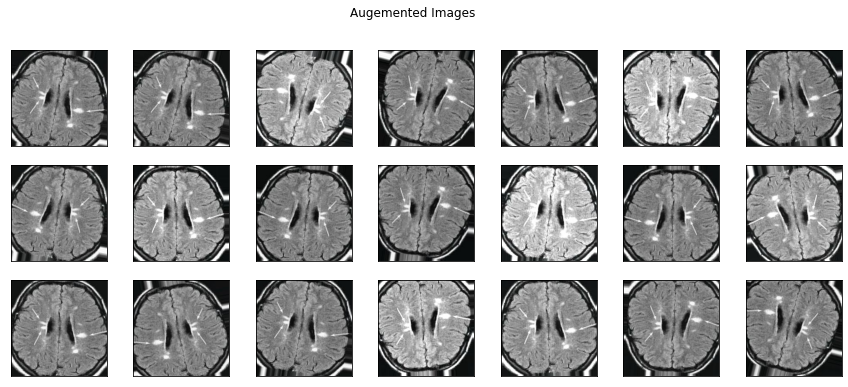

In [40]:
plt.imshow(X_train_crop[0])
plt.xticks([])
plt.yticks([])
plt.title('Original Image')
plt.show()

plt.figure(figsize=(15,6))
i = 1
for img in os.listdir('preview/'):
    img = cv2.imread('preview/' + img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(3,7,i)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
    i += 1
    if i > 3*7:
        break
plt.suptitle('Augemented Images')
plt.show()

In [41]:
TRAIN_DIR = 'TRAIN_CROP/'
VAL_DIR = 'VAL_CROP/'
TEST_DIR = 'TEST_CROP/'

RANDOM_SEED = 123

train_datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    brightness_range=[0.5, 1.5],
    horizontal_flip=True,
    vertical_flip=True,
    preprocessing_function=preprocess_input
)

test_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input
)

# Create a test data generator flow
test_generator = test_datagen.flow_from_directory(
    TEST_DIR,
    color_mode='rgb',
    target_size=IMG_SIZE,  
    batch_size=32,         
    class_mode='binary',   
    shuffle=False,         
    seed=RANDOM_SEED
)

train_generator = train_datagen.flow_from_directory(
    TRAIN_DIR,
    color_mode='rgb',
    target_size=IMG_SIZE,
    batch_size=32,
    class_mode='binary',
    seed=RANDOM_SEED
)


validation_generator = test_datagen.flow_from_directory(
    VAL_DIR,
    color_mode='rgb',
    target_size=IMG_SIZE,
    batch_size=32,
    class_mode='binary',
    seed=RANDOM_SEED
)

Found 179 images belonging to 2 classes.
Found 37 images belonging to 2 classes.


ImageDataGenerator is employed to perform real-time data augmentation on images located in the TRAIN_CROP directory for training and the VAL_CROP directory for validation. The augmentation process includes random transformations such as rotations, shifts, shearing, brightness adjustments, and flips. Simultaneously, the images are resized to IMG_SIZE and preprocessed. The train_generator and validation_generator are configured to generate batches of RGB images, along with their binary labels, for training and validation, respectively. This setup ensures efficient data feeding into the deep learning model, enabling the model to learn from augmented data during training while using consistent data for validation.

### <B>3. Baseline Model</B><a class="anchor" id="Model"></a>

#### <B>CNN</B>

The CNN is designed for binary classification: identifying whether an MRI scan contains a brain tumor or not. The output layer uses a sigmoid activation function since the task involves two classes: "Tumor" (Class 1) and "No Tumor" (Class 0), which aligns with the project's goal of classifying brain MRI images.

In [42]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.optimizers import Adam

# Define a simple CNN model
def build_cnn(input_shape=(224, 224, 3), num_classes=1):
    model = Sequential()
    
    # First convolutional layer
    model.add(Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=input_shape))
    model.add(MaxPooling2D((2, 2)))
    
    # Second convolutional layer
    model.add(Conv2D(64, (3, 3), activation='relu', padding='same'))
    model.add(MaxPooling2D((2, 2)))
    
    # Third convolutional layer
    model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
    model.add(MaxPooling2D((2, 2)))
    
    # Flatten the feature maps
    model.add(Flatten())
    
    # Fully connected layer
    model.add(Dense(128, activation='relu'))
    model.add(Dropout(0.5))
    
    # Output layer
    model.add(Dense(num_classes, activation='sigmoid' if num_classes == 1 else 'softmax'))
    
    return model

# Instantiate the CNN model
cnn_model = build_cnn()

# Compile the model
cnn_model.compile(
    loss='binary_crossentropy',  # Use 'categorical_crossentropy' for multi-class classification
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy']
)

# Display the model summary
cnn_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 56, 56, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 28, 28, 128)      0

2024-09-04 21:13:44.486542: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [43]:
# Adjust steps_per_epoch and validation_steps according to the dataset size
steps_per_epoch = len(train_generator)  # roughly 6
validation_steps = len(validation_generator)  # roughly 3

# Train the model with the adjusted parameters
cnn_history = cnn_model.fit(
    train_generator,
    steps_per_epoch=steps_per_epoch,
    epochs=20,
    validation_data=validation_generator,
    validation_steps=validation_steps
)

Epoch 1/20
6/6 [==============================] - 7s 985ms/step - loss: 15.3736 - accuracy: 0.5531 - val_loss: 6.5130 - val_accuracy: 0.5405
Epoch 2/20
6/6 [==============================] - 6s 982ms/step - loss: 10.1999 - accuracy: 0.5140 - val_loss: 4.0240 - val_accuracy: 0.6216
Epoch 3/20
6/6 [==============================] - 6s 975ms/step - loss: 6.8827 - accuracy: 0.5642 - val_loss: 6.6558 - val_accuracy: 0.3784
Epoch 4/20
6/6 [==============================] - 6s 1s/step - loss: 3.6091 - accuracy: 0.4693 - val_loss: 1.5694 - val_accuracy: 0.6216
Epoch 5/20
6/6 [==============================] - 6s 988ms/step - loss: 2.1520 - accuracy: 0.5922 - val_loss: 0.8368 - val_accuracy: 0.4595
Epoch 6/20
6/6 [==============================] - 8s 1s/step - loss: 1.1215 - accuracy: 0.4804 - val_loss: 0.6834 - val_accuracy: 0.5676
Epoch 7/20
6/6 [==============================] - 7s 1s/step - loss: 0.7134 - accuracy: 0.5810 - val_loss: 0.5902 - val_accuracy: 0.6216
Epoch 8/20
6/6 [===========

The model is trained over 20 epochs. Each epoch represents a full pass through the training data, with the model learning from it. After each epoch, the model’s performance is evaluated on the validation set to track its ability to generalize.
The metrics being tracked are loss (binary cross-entropy in this case) and accuracy. You will also need to track precision, recall, F1-score, and confusion matrix for more insight into model performance, particularly since this is a medical detection task and you need to ensure the model performs well on both the "Tumor" and "No Tumor" classes.

In [44]:
# Evaluate on the validation set
val_loss, val_acc = cnn_model.evaluate(validation_generator, verbose=0)
print(f'Validation Accuracy: {val_acc:.4f}')

# Assuming X_test_prep and y_test are predefined for the test set
# Evaluate on the test set
test_loss, test_acc = cnn_model.evaluate(X_test_prep, y_test, verbose=0)
print(f'Test Accuracy: {test_acc:.4f}')

Validation Accuracy: 0.7838
Test Accuracy: 0.6216


Test Set Evaluation:

The line test_loss, test_acc = cnn_model.evaluate(X_test_prep, y_test, verbose=0) computes the accuracy on the test set. Here, the test accuracy is 0.6216, which is lower than the validation accuracy.
Purpose: This step is crucial in real-world deployment scenarios. The test set represents completely unseen data, and the performance here gives a final indication of how well the model generalizes beyond the validation set. 

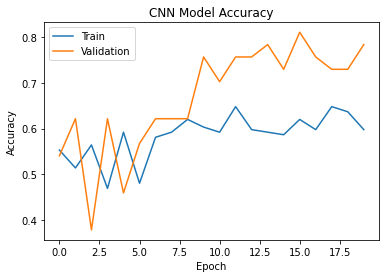

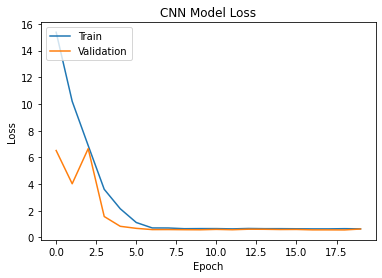

In [45]:
import matplotlib.pyplot as plt

# Plot training & validation accuracy values
plt.plot(cnn_history.history['accuracy'])
plt.plot(cnn_history.history['val_accuracy'])
plt.title('CNN Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values
plt.plot(cnn_history.history['loss'])
plt.plot(cnn_history.history['val_loss'])
plt.title('CNN Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [61]:
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score

# Make predictions on the test set
predictions = cnn_model.predict(X_test_prep)

# Convert probabilities to binary predictions (assuming binary classification)
predictions = [1 if x > 0.5 else 0 for x in predictions]

# Calculate accuracy
accuracy = accuracy_score(y_test, predictions)

# Calculate precision
precision = precision_score(y_test, predictions, average='weighted', zero_division=0)

# Calculate recall
recall = recall_score(y_test, predictions, average='weighted', zero_division=0)

# Calculate F1 score
f1 = f1_score(y_test, predictions, average='weighted', zero_division=0)

# Print classification report (for binary classification, provide two class names)
print(classification_report(y_test, predictions, target_names=['No Tumor', 'Tumor'], zero_division=0))

              precision    recall  f1-score   support

    No Tumor       0.50      0.57      0.53        15
       Tumor       0.71      0.65      0.68        17

    accuracy                           0.62        32
   macro avg       0.61      0.61      0.61        32
weighted avg       0.63      0.62      0.63        32


<u>Performance metrics analysis</u>

Strengths: The model demonstrates better performance in identifying "Tumor" cases compared to "No Tumor" cases, with higher precision and recall for the "Tumor" class. This is important for medical imaging where false positives for tumors are better than missing actual tumors.

Weaknesses: The precision for the "No Tumor" class is quite low at 0.50, which means the model is making a lot of incorrect "No Tumor" predictions. Similarly, the recall for "No Tumor" is also low at 0.57, meaning it misses many actual "No Tumor" cases. Overall, the accuracy of 62% indicates that the model is struggling to provide reliable predictions across both classes.



### <b>4. U-Net Image Segmentation for detecting brain tumor </b> <a class="anchor" id="net"></a>

1. Making Mask

2. Preparing data

3. Building U-net CNN model

4. Training the model

5. Evalutation Model on some training data

6. Evaluation model on the test data

#### <u>Making masks</u>

In this project tumors in yes images are masks. 

Lets look at some masks and images:

In [27]:
# Define paths to your dataset
data_dir = "./brain_tumor_dataset"
image_dir = os.path.join(data_dir, "yes")  # Directory for images with tumors
mask_dir = os.path.join(data_dir, "masks")

# Create the masks directory if it doesn't exist
if not os.path.exists(mask_dir):
    os.makedirs(mask_dir)

# Function to create mask for a single image
def create_mask(image_path):
    # Read the MRI image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    
    # Perform image processing and segmentation to generate the mask
    # Here you would implement your specific algorithm for segmentation
    
    # For example, you might use thresholding
    threshold_value = 127  # Example threshold value
    _, thresholded = cv2.threshold(image, threshold_value, 255, cv2.THRESH_BINARY)
    
    # Or you might use more advanced techniques like deep learning-based segmentation
    
    # Save the generated mask
    mask_filename = os.path.basename(image_path).replace(".jpg", "_mask.jpg")  # Adjust extension if necessary
    mask_path = os.path.join(mask_dir, mask_filename)
    cv2.imwrite(mask_path, thresholded)
    
    return thresholded

# Iterate through each image in the dataset and generate masks
for image_name in os.listdir(image_dir):
    if image_name.endswith(".jpg"):  # Adjust extension if necessary
        image_path = os.path.join(image_dir, image_name)
        create_mask(image_path)

print("Masks created successfully.")

Masks created successfully.


In this code, the masks are custom-generated rather than being pre-labeled. We are manually creating masks for each MRI image through thresholding, a simple segmentation technique. The thresholding method classifies pixels based on their intensity (brightness), and this results in a binary mask that attempts to highlight potential tumor regions.

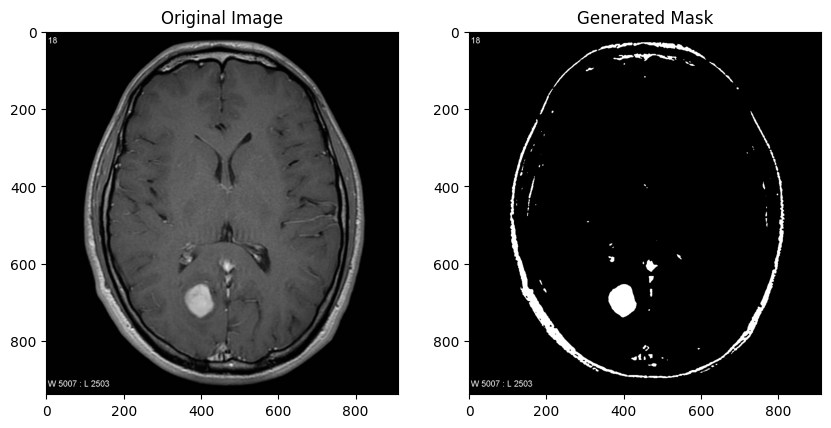

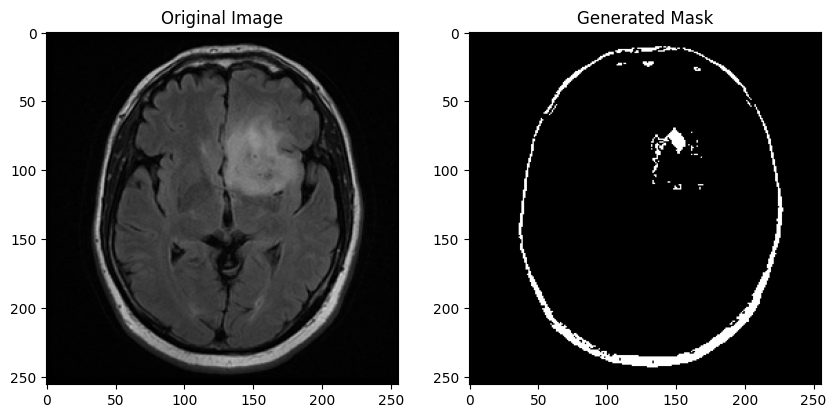

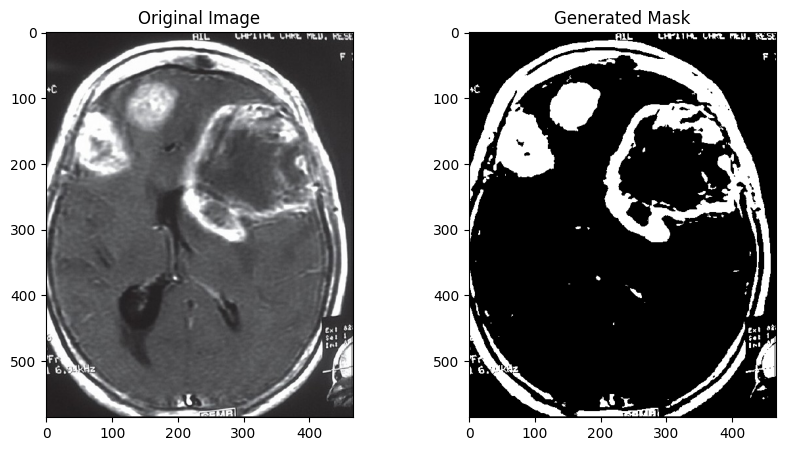

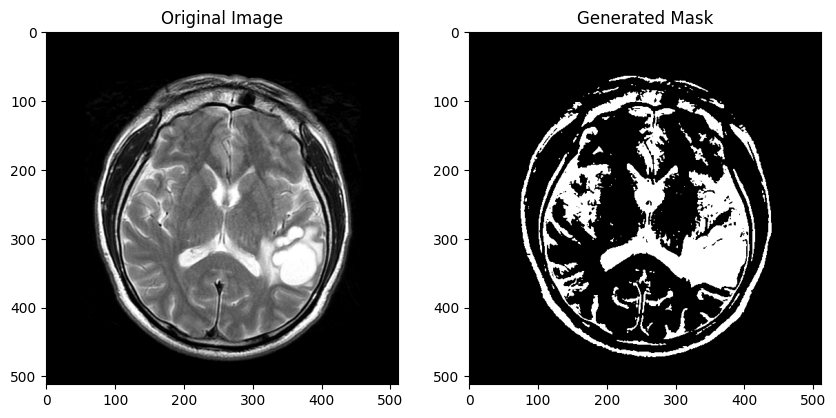

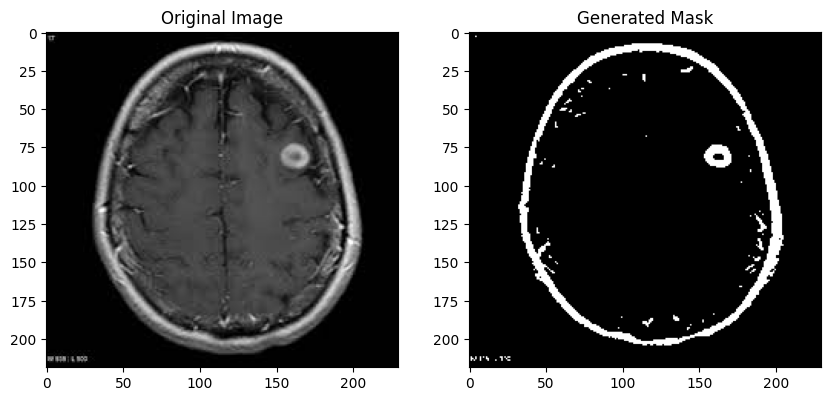

...

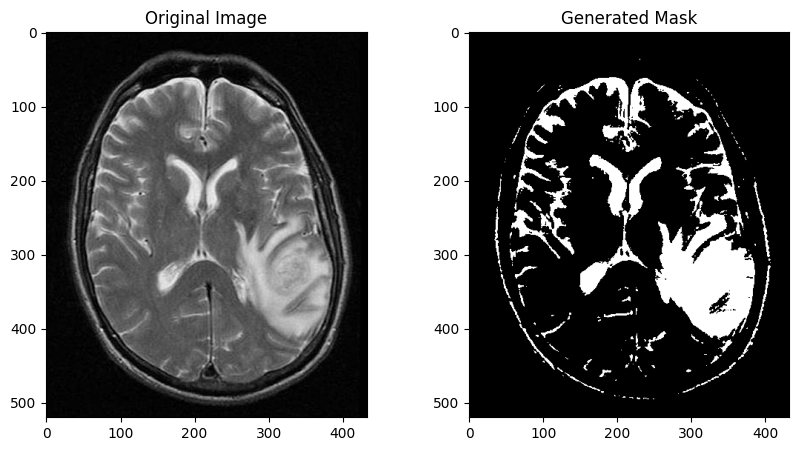

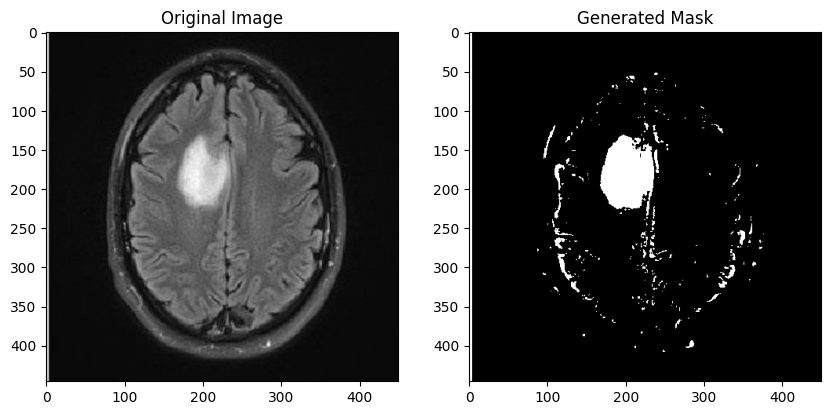

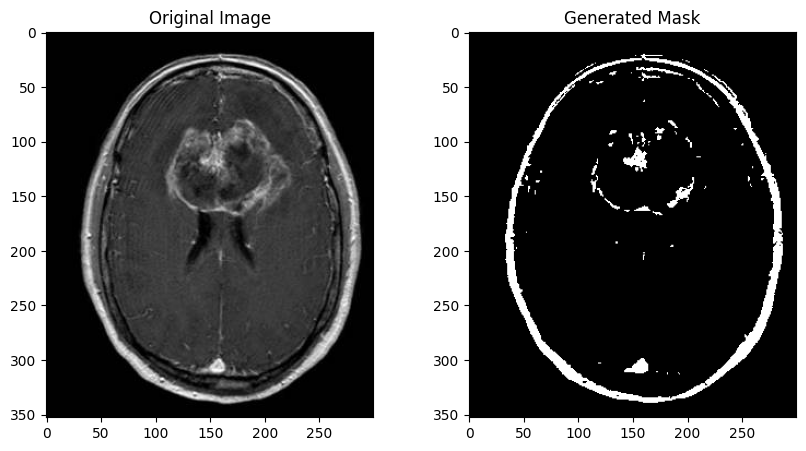

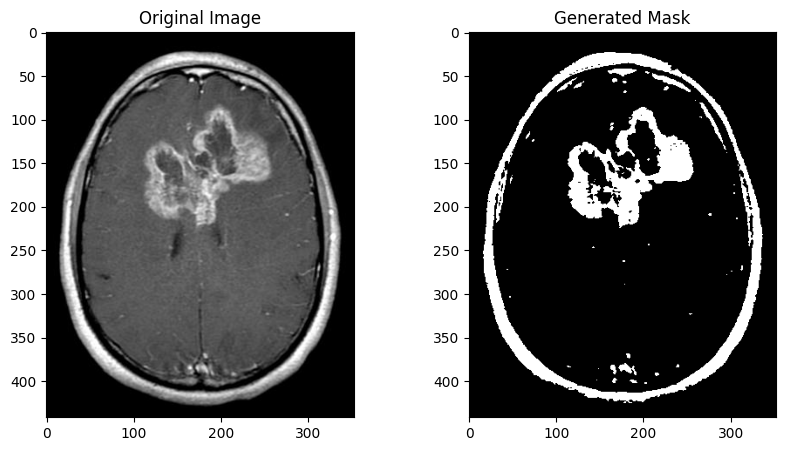

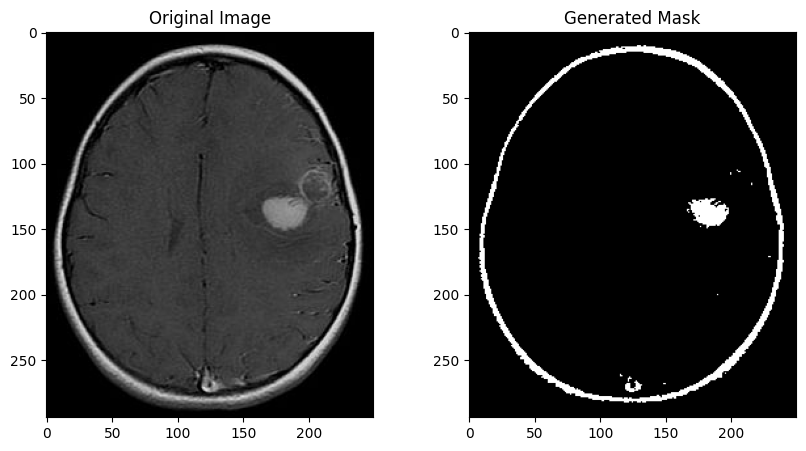

Masks created and visualized successfully.


In [28]:
# Iterate through each image in the dataset, generate masks, and plot the images with masks
for image_name in os.listdir(image_dir):
    if image_name.endswith(".jpg"):  # Adjust extension if necessary
        image_path = os.path.join(image_dir, image_name)
        mask = create_mask(image_path)
        
        # Plot the original image and its mask
        fig, axarr = plt.subplots(1, 2, figsize=(10, 5))
        original_image = cv2.imread(image_path)
        axarr[0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
        axarr[0].set_title('Original Image')
        
        axarr[1].imshow(mask, cmap='gray')
        axarr[1].set_title('Generated Mask')
        
        plt.show()

print("Masks created and visualized successfully.")

#### <b><u>Preparing mask data</u></b>

In [29]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
import tensorflow as tf

# Define paths to your dataset
data_dir = "./brain_tumor_dataset"
image_dir = os.path.join(data_dir, "yes")  # Directory for images with tumors
mask_dir = os.path.join(data_dir, "masks")

# Augmentation techniques 
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip('horizontal'),
    tf.keras.layers.RandomRotation(0.05, fill_mode="reflect", fill_value=0.0)
])

# Function to load and preprocess the data
def load_data(image_dir, mask_dir, image_size=(224, 224)):
    images = []
    masks = []
    for image_name in os.listdir(image_dir):
        if image_name.endswith(".jpg"):  # Adjust extension if necessary
            image_path = os.path.join(image_dir, image_name)
            mask_path = os.path.join(mask_dir, image_name.replace(".jpg", "_mask.jpg"))  # Adjust extension if necessary
            
            # Load and resize the image and mask
            image = cv2.imread(image_path)
            image = cv2.resize(image, image_size)
            mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
            mask = cv2.resize(mask, image_size)
            
            # Normalize the image and mask
            image = image / 255.0
            mask = mask / 255.0
            
            # Apply data augmentation
            image_augmented = data_augmentation(tf.expand_dims(image, axis=0))
            image = tf.squeeze(image_augmented, axis=0).numpy()  # Return back to the original shape
            
            images.append(image)
            masks.append(mask)
            
    return np.array(images), np.array(masks)

# Load the data
images, masks = load_data(image_dir, mask_dir)

# Split the data into training and validation sets
train_images, val_images, train_masks, val_masks = train_test_split(images, masks, test_size=0.2, random_state=42)

print("Data prepared successfully.")

/Users/nikhitha/Library/Python/3.9/lib/python/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


Data prepared successfully.


Let's look at images and masks after preparation

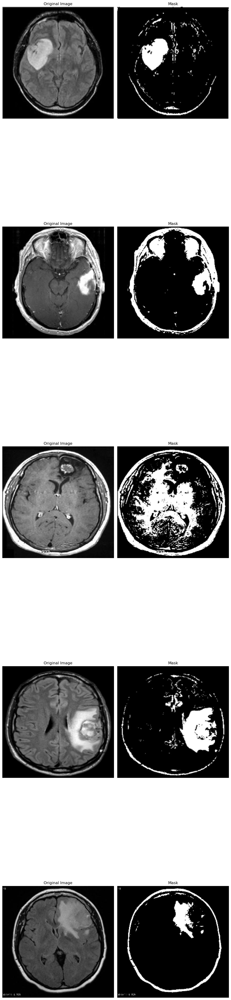

In [4]:
import matplotlib.pyplot as plt

# Function to display images and masks
def display_images_and_masks(images, masks, num_samples=5):
    fig, axes = plt.subplots(num_samples, 2, figsize=(10, 10*num_samples))
    for i in range(num_samples):
        # Display original image
        axes[i, 0].imshow(images[i])
        axes[i, 0].set_title('Original Image')
        axes[i, 0].axis('off')
        
        # Display mask
        axes[i, 1].imshow(masks[i], cmap='gray')
        axes[i, 1].set_title('Mask')
        axes[i, 1].axis('off')

    plt.tight_layout()
    plt.show()

# Display some images and masks
num_samples = 5
display_images_and_masks(train_images[:num_samples], train_masks[:num_samples])

<b><u>Building U-net Model</u></b>

In [9]:
# Build U-Net model
# Note we make our layers variables so that we can concatenate or stack
# This is required so that we can re-create our U-Net Model

IMG_HEIGHT = 224
IMG_WIDTH = 224
IMG_CHANNELS = 3

# Input layer, where the input image is normalized to the range [0, 1]
inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
s = Lambda(lambda x: x / 255) (inputs)  # Scale pixel values to [0, 1]

# ----- Encoder Path -----
# This section down-samples the input image, extracting increasingly complex features at lower resolutions.

# Encoder Block 1: First convolutional block with 16 filters
c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (s)
c1 = Dropout(0.1) (c1)  # Dropout to prevent overfitting
c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c1)
p1 = MaxPooling2D((2, 2)) (c1)  # MaxPooling reduces the spatial dimension

# Encoder Block 2: Convolutional block with 32 filters
c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p1)
c2 = Dropout(0.1) (c2)
c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c2)
p2 = MaxPooling2D((2, 2)) (c2)

# Encoder Block 3: Convolutional block with 64 filters
c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p2)
c3 = Dropout(0.2) (c3)
c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c3)
p3 = MaxPooling2D((2, 2)) (c3)

# Encoder Block 4: Convolutional block with 128 filters
c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p3)
c4 = Dropout(0.2) (c4)
c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c4)
p4 = MaxPooling2D(pool_size=(2, 2)) (c4)

# Bottom of the U-Net (bottleneck layer): Convolutional block with 256 filters
# This layer represents the deepest part of the U-Net, where the model has the smallest spatial resolution but the highest number of features.
c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p4)
c5 = Dropout(0.3) (c5)
c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c5)

# ----- Decoder Path -----
# This section up-samples the image, combining features from the encoder to create a high-resolution output.

# Decoder Block 1: Up-sample and concatenate features from the encoder block 4
u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same') (c5)  # Transposed convolution to upsample
u6 = concatenate([u6, c4])  # Skip connection concatenates the features from the corresponding encoder layer
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u6)
c6 = Dropout(0.2) (c6)
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c6)

# Decoder Block 2: Up-sample and concatenate features from the encoder block 3
u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same') (c6)
u7 = concatenate([u7, c3])  # Skip connection
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u7)
c7 = Dropout(0.2) (c7)
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c7)

# Decoder Block 3: Up-sample and concatenate features from the encoder block 2
u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same') (c7)
u8 = concatenate([u8, c2])  # Skip connection
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u8)
c8 = Dropout(0.1) (c8)
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c8)

# Decoder Block 4: Up-sample and concatenate features from the encoder block 1
u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same') (c8)
u9 = concatenate([u9, c1], axis=3)  # Skip connection
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u9)
c9 = Dropout(0.1) (c9)
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c9)

# Output layer: 1 filter with sigmoid activation for binary segmentation (tumor vs. no tumor)
outputs = Conv2D(1, (1, 1), activation='sigmoid') (c9)

# Compile the model with Adam optimizer and binary cross-entropy loss for segmentation tasks
model = Model(inputs=[inputs], outputs=[outputs])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda (Lambda)     │ (None, 224, 224,  │          0 │ input_layer[0][0] │
│                     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 224, 224,  │        448 │ lambda[0][0]      │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 224, 224,  │          0 │ conv2d[0][0]      │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 224, 224,  │      2,320 │ dropout[0][0]     │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 112, 112,  │          0 │ conv2d_1[0][0]    │
│ (MaxPooling2D)      │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 112, 112,  │      4,640 │ max_pooling2d[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 112, 112,  │          0 │ conv2d_2[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 112, 112,  │      9,248 │ dropout_1[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 56, 56,    │          0 │ conv2d_3[0][0]    │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 56, 56,    │     18,496 │ max_pooling2d_1[… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_2 (Dropout) │ (None, 56, 56,    │          0 │ conv2d_4[0][0]    │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 56, 56,    │     36,928 │ dropout_2[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_2     │ (None, 28, 28,    │          0 │ conv2d_5[0][0]    │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_6 (Conv2D)   │ (None, 28, 28,    │     73,856 │ max_pooling2d_2[… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_3 (Dropout) │ (None, 28, 28,    │          0 │ conv2d_6[0][0]    │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_7 (Conv2D)   │ (None, 28, 28,    │    147,584 │ dropout_3[0][0] 

 Total params: 1,941,105 (7.40 MB)

 Trainable params: 1,941,105 (7.40 MB)

 Non-trainable params: 0 (0.00 B)

The U-Net model architecture is designed for image segmentation tasks, specifically for brain tumor segmentation in MRI images. U-Net consists of an encoder-decoder structure that allows the model to capture fine details (high-resolution features) while maintaining context through downsampling.

1. Input Layer:
The input is an MRI image with dimensions 224x224x3 (height, width, and channels). A Lambda layer is applied to normalize the pixel values to the range [0, 1].
2. Encoder Path (Downsampling):
The encoder extracts features from the input image by applying a series of convolutional layers, each followed by max-pooling layers to reduce the spatial dimensions.
Each convolutional block consists of two convolutional layers with ELU activation and filters of increasing size (16, 32, 64, 128, 256) as the network goes deeper. Dropout layers are included to prevent overfitting.
The output of each block is stored for later use in the decoder path through skip connections.
3. Bottleneck (Bridge between Encoder and Decoder):
At the bottom of the U-Net, there is a convolutional block with 256 filters. This is where the spatial resolution is lowest, but the feature map contains the most complex representations of the input image.
4. Decoder Path (Upsampling):
The decoder reconstructs the high-resolution output by upsampling the feature maps. Transposed convolutional layers are used to increase the spatial resolution.
Skip connections from the corresponding encoder blocks are concatenated with the decoder layers, allowing the model to retain fine details from the high-resolution features of the encoder.
The decoder uses convolutional blocks with progressively fewer filters (128, 64, 32, 16).
5. Output Layer:
The final output layer uses a single convolutional filter with a sigmoid activation function, producing a binary segmentation map (indicating tumor vs. no tumor for each pixel).
6. Compilation:
The U-Net model is compiled using the Adam optimizer and binary cross-entropy loss, which is suitable for this binary segmentation task.
Accuracy is used as the metric to monitor performance during training.
This U-Net architecture leverages skip connections to ensure that fine details from the input image are retained in the final output, making it highly effective for segmentation tasks like brain tumor detection in MRI scans.

<u><b>Training the model</b></u>

In [103]:
model_path = "nuclei_finder_unet_1.h5"
# Initialize our callbacks

checkpoint = ModelCheckpoint(model_path,
                             monitor="val_loss",
                             mode="min",
                             save_best_only = True,
                             verbose=1)

earlystop = EarlyStopping(monitor = 'val_loss', 
                          min_delta = 0, 
                          patience = 5,
                          verbose = 1,
                          restore_best_weights = True)

# Fit our model 
results = model.fit(train_images, train_masks, validation_data=(val_images, val_masks),
                    batch_size=16, epochs=10,callbacks=[earlystop, checkpoint])

Train on 109 samples, validate on 13 samples
Epoch 1/10
109/109 [==============================] - ETA: 0s - loss: 0.4480 - accuracy: 0.8667
Epoch 00001: val_loss improved from inf to 0.29573, saving model to nuclei_finder_unet_1.h5
109/109 [==============================] - 16s 148ms/sample - loss: 0.4480 - accuracy: 0.8667 - val_loss: 0.2957 - val_accuracy: 0.9193
Epoch 2/10
109/109 [==============================] - ETA: 0s - loss: 0.3129 - accuracy: 0.9038
Epoch 00002: val_loss improved from 0.29573 to 0.20947, saving model to nuclei_finder_unet_1.h5
109/109 [==============================] - 10s 88ms/sample - loss: 0.3129 - accuracy: 0.9038 - val_loss: 0.2095 - val_accuracy: 0.9235
Epoch 3/10
109/109 [==============================] - ETA: 0s - loss: 0.2465 - accuracy: 0.9110
Epoch 00003: val_loss improved from 0.20947 to 0.18851, saving model to nuclei_finder_unet_1.h5
109/109 [==============================] - 10s 91ms/sample - loss: 0.2465 - accuracy: 0.9110 - val_loss: 0.1885 

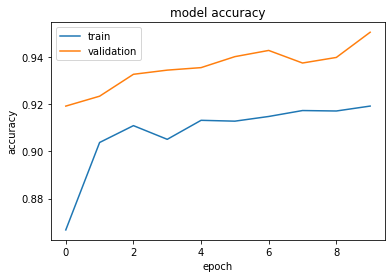

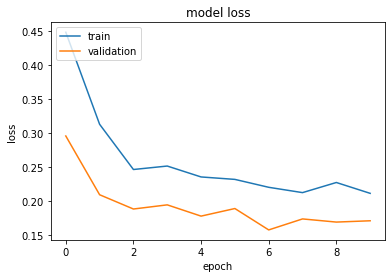

In [164]:
plt.plot(results.history['accuracy'])
plt.plot(results.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
    
# "Loss"
plt.plot(results.history['loss'])
plt.plot(results.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

The plots above depict the model accuracy and model loss for both the training and validation sets over 10 epochs during the training of the U-Net model. These metrics are crucial for evaluating how well the model performs in predicting brain tumor regions in MRI images.

1. Model Accuracy:
The training accuracy starts at around 88% and steadily improves to approximately 91% by the final epoch.
The validation accuracy consistently remains higher than the training accuracy, reaching around 94% by the end.
The increasing trend in both training and validation accuracy suggests that the model is learning effectively and generalizing well to unseen validation data, with minimal signs of overfitting.
2. Model Loss:
The training loss starts high at around 0.45 but rapidly decreases and stabilizes around 0.17, indicating that the model is minimizing errors during training.
The validation loss shows a similar trend, dropping from approximately 0.28 to about 0.17, and closely follows the training loss curve.
Both loss curves indicate effective training, with the model converging well. The similarity in training and validation losses suggests that the model is not overfitting and is generalizing well to unseen data.

#### <u>Model evaluation on training data</u>

Now let's look at the traing data evaluation :

In [104]:
model = load_model('nuclei_finder_unet_1.h5', 
                   custom_objects={'my_iou_metric': my_iou_metric})

# the first 90% was used for training
preds_train = model.predict(X_train[:int(X_train.shape[0]*0.9)], verbose=1)


#preds_test = model.predict(X_test, verbose=1)

# Threshold predictions
preds_train_t = (preds_train > 0.5).astype(np.uint8)

In [62]:
import numpy as np
from tensorflow.keras.models import load_model

# Load the model with custom IoU metric
model = load_model('nuclei_finder_unet_1.h5', custom_objects={'my_iou_metric': my_iou_metric})

# The first 90% of training data was used for training
preds_train = model.predict(X_train[:int(X_train.shape[0]*0.9)], verbose=1)

# Threshold the predictions to convert them into binary masks (0 or 1)
preds_train_t = (preds_train > 0.5).astype(np.uint8)

# Define the IoU function
def iou_metric(y_true, y_pred):

# Calculate Intersection over Union (IoU).

    # Flatten the masks to 1D arrays
    y_true = y_true.flatten()
    y_pred = y_pred.flatten()

    # Intersection and Union
    intersection = np.sum(np.logical_and(y_true == 1, y_pred == 1))
    union = np.sum(np.logical_or(y_true == 1, y_pred == 1))

    # Compute IoU
    if union == 0:
        return 0.0  # Avoid division by zero if both masks are empty
    else:
        return intersection / union

# Example: Calculate IoU for a single mask (the first mask)
true_mask = y_train[:int(X_train.shape[0]*0.9)][0]  # Ground truth for the first image
pred_mask = preds_train_t[0]  # Predicted mask for the first image

# Calculate IoU for the first mask
iou_score = iou_metric(true_mask, pred_mask)

# Print the IoU score
print(f"IoU Score: {iou_score:.4f}")

IoU Score: 0.8234


This code evaluates the U-Net model’s segmentation performance on the training set using the Intersection over Union (IoU) metric. IoU is a critical evaluation metric for segmentation tasks, as it measures the overlap between the predicted masks and the ground truth masks.

1. Model Loading:

The pre-trained U-Net model is loaded using load_model(), with a custom IoU metric (my_iou_metric) included to assess segmentation performance.

2. Predictions:

Predictions are made on the first 90% of the training data (X_train[:int(X_train.shape[0]*0.9)]) using the model’s predict() function.
The output predictions are raw probabilities between 0 and 1, representing the likelihood of each pixel being part of a tumor.

3. Thresholding Predictions:

The predicted probabilities are converted into binary masks using a threshold of 0.5. This step ensures that each pixel is classified as either 0 (non-tumor) or 1 (tumor), matching the format of the ground truth masks.

4. IoU Metric:

The IoU function is defined to calculate the Intersection over Union (IoU), which quantifies the overlap between the predicted mask and the true mask.
For each mask, IoU is calculated by dividing the intersection of the predicted and true mask (pixels labeled as tumor in both) by their union (all pixels labeled as tumor in either).
A perfect IoU score of 1.0 indicates complete overlap between the prediction and the ground truth, while lower values indicate less accurate predictions.

The code calculates the IoU score for the first mask in the training set. In this example, an IoU score of 0.8234 is obtained, indicating a high degree of overlap between the predicted and true tumor regions.

Plotting the evalution of the data on the training set :

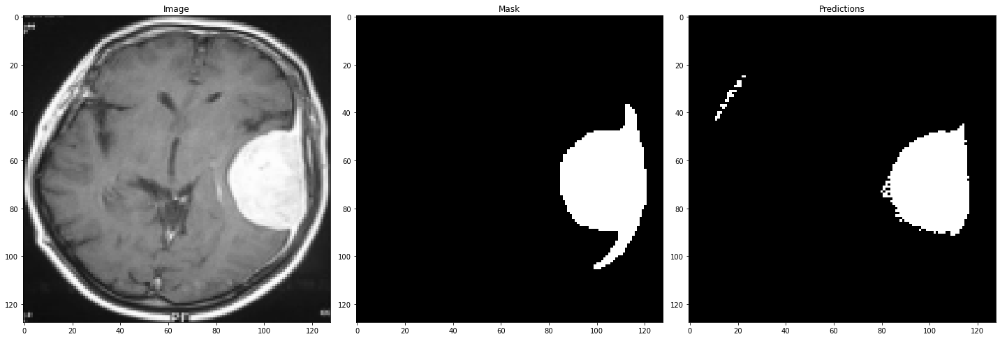

In [106]:
# Ploting our predicted masks
ix = random.randint(0, 120)
plt.figure(figsize=(20,20))

# Our original training image
plt.subplot(131)
imshow(X_train[ix])
plt.title("Image")

# Our original combined mask  
plt.subplot(132)
imshow(np.squeeze(Y_train[ix]))
plt.title("Mask")

# The mask our U-Net model predicts
plt.subplot(133)
imshow(np.squeeze(preds_train_t[ix] > 0.5))
plt.title("Predictions")
plt.show()

- The left subplot displays the original MRI image.
- The middle subplot displays the ground truth mask (the actual tumor region, represented as a binary mask).
- The right subplot shows the predicted mask generated by your U-Net model, which segments the tumor region.

This visualization helps to assess how well the U-Net model is performing in terms of segmenting the tumor regions compared to the ground truth. We can visually inspect how closely the predicted masks overlap with the true tumor areas, which gives immediate feedback on the model’s segmentation quality.

#### <u>Model evaluation on test data</u>

By visualizing the predictions on test data, you can get a sense of how well your model generalizes to unseen data.

First let's evaluate the model on the test data (First we read test images from testData folder)

In [152]:
import os
import cv2
import numpy as np
data=[]
for dirname, _, filenames in os.walk('TEST_CROP/'):
    for filename in filenames:
        img=cv2.imread(os.path.join(dirname, filename))
        if img is not None:
                data.append(img)
        
data1=np.array(data)

Test data Prediction: 

In [153]:
preds_test = model.predict(data1, verbose=1)

# Threshold predictions
preds_test_t = (preds_train > 0.5).astype(np.uint8)

Test Data Evaluation:

In [154]:
preds_test = model.predict(data1, verbose=1)

preds_test_t = (preds_test > 0.5).astype(np.uint8)

Evaluation results and Plot :

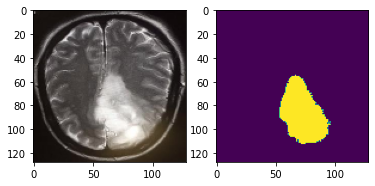

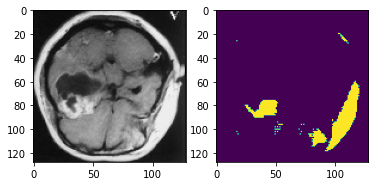

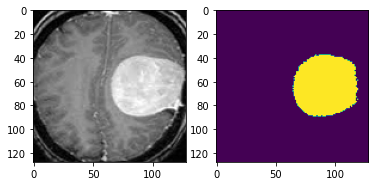

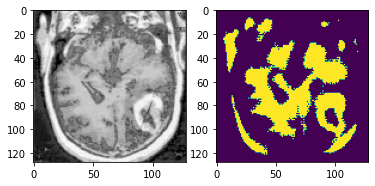

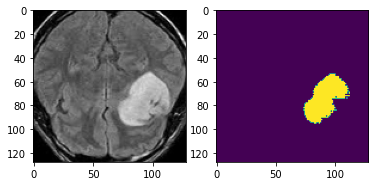

...

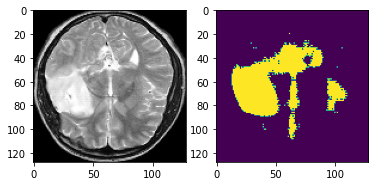

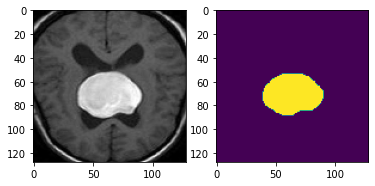

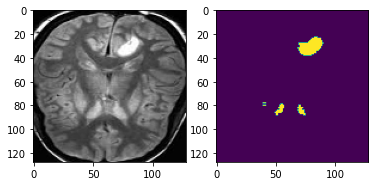

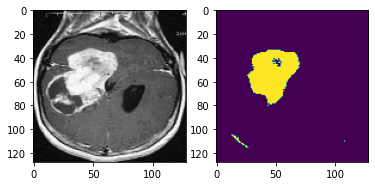

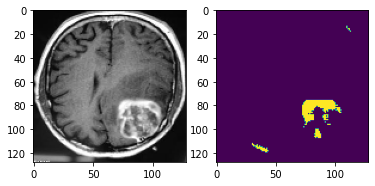

In [161]:
for n in range(len(data)):
    f = plt.figure()
    f.add_subplot(1,2, 1)
    plt.imshow(np.rot90(data[n],2))
    f.add_subplot(1,2, 2)
    plt.imshow(np.rot90(np.squeeze(preds_test_t[n]),2))
    plt.show(block=True)

By comparing the predicted masks with the original MRI images and ground truth masks, we can qualitatively assess the model’s ability to segment brain tumors. Furthermore, this is an important step in model evaluation, ensuring the U-Net is able to generalize well and perform accurate segmentation on unseen data, critical in a medical application like brain tumor detection.

### 5. Transfer Learning VGG16 Model<a class="anchor" id="trans"></a>

#### <u>Building the model</u>

Load the VGG16 architecture with pretrained imagenet weights, set trainable to false to freeze the weights during training

In [14]:
base_model = tf.keras.applications.VGG16(input_shape=img_shape,include_top=False,
                                         weights = "imagenet"
                                         )
base_model.trainable = False

Define the classification head, a global average pooling layer for the 7x7 spatial locations to a single 512 len vector per image

In [15]:
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
prediction_layer = tf.keras.layers.Dense(1)

In [16]:
inputs = tf.keras.Input(shape=img_shape)
x=data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x,training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.25)(x)
x = tf.keras.layers.Dense(units=256,activation='relu')(x)
outputs = prediction_layer(x)

model = tf.keras.Model(inputs,outputs)

1. VGG16 Base Model:

base_model: The pretrained VGG16 model is loaded with weights from ImageNet, excluding the top fully connected layers (include_top=False). This model acts as a feature extractor, capturing rich features from MRI images without requiring full retraining.
base_model.trainable = False: The pretrained VGG16 layers are frozen, meaning their weights will not be updated during training. This helps speed up training and reduces the risk of overfitting, especially with smaller datasets.

2. Custom Head for Classification:

A custom global average pooling layer (GlobalAveragePooling2D) is added after the convolutional layers of VGG16. This converts the spatial features into a 1D vector, suitable for feeding into fully connected layers.
A Dropout layer with a rate of 0.25 is added to reduce overfitting.
A dense layer with 256 units and ReLU activation is added to learn non-linear combinations of the extracted features.
A final prediction layer (Dense(1)) outputs a single value, which represents the predicted class for tumor presence.

3. Defining the Model:

The inputs are processed through data augmentation and the VGG16 feature extractor (base_model(x)).
The final classification is performed using the custom layers, which include dropout and dense layers, resulting in an output suitable for binary classification.

#### <u>Compile the model</u>

In [17]:
base_learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=base_learning_rate),
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics=['accuracy']
              )

early_stopping = keras.callbacks.EarlyStopping(patience = 40,
                                               min_delta=0.001,
                                               restore_best_weights=True
                                               )

In [18]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
sequential (Sequential)      (None, 224, 224, 3)       0         
_________________________________________________________________
tf.__operators__.getitem (Sl (None, 224, 224, 3)       0         
_________________________________________________________________
tf.nn.bias_add (TFOpLambda)  (None, 224, 224, 3)       0         
_________________________________________________________________
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
global_average_pooling2d (Gl (None, 512)               0         
_________________________________________________________________
dropout (Dropout)            (None, 512)               0     

#### <u>Train the model</u>

In [19]:
#Initial accuracy with only pretrained weights is 0.36
initial_epochs = 200

loss0, accuracy0 = model.evaluate(validation_generator)

1/1 [==============================] - 7s 7s/step - loss: 0.7479 - accuracy: 0.5556


In [20]:
history = model.fit(train_generator,
                    epochs=initial_epochs,
                    validation_data=validation_generator,
                    callbacks=[early_stopping]
                    )

Epoch 1/200
7/7 [==============================] - 4s 192ms/step - loss: 1.1453 - accuracy: 0.5616 - val_loss: 0.5806 - val_accuracy: 0.7778
Epoch 2/200
7/7 [==============================] - 1s 76ms/step - loss: 1.1027 - accuracy: 0.5665 - val_loss: 0.4740 - val_accuracy: 0.8333
Epoch 3/200
7/7 [==============================] - 1s 67ms/step - loss: 0.9231 - accuracy: 0.6453 - val_loss: 0.5162 - val_accuracy: 0.9444
Epoch 4/200
7/7 [==============================] - 1s 66ms/step - loss: 0.7498 - accuracy: 0.6946 - val_loss: 0.2166 - val_accuracy: 0.9444
Epoch 5/200
7/7 [==============================] - 1s 69ms/step - loss: 0.5361 - accuracy: 0.7635 - val_loss: 0.2426 - val_accuracy: 0.8333
Epoch 6/200
7/7 [==============================] - 1s 66ms/step - loss: 0.6112 - accuracy: 0.7291 - val_loss: 0.4905 - val_accuracy: 0.8333
Epoch 7/200
7/7 [==============================] - 1s 66ms/step - loss: 0.4537 - accuracy: 0.8030 - val_loss: 0.1339 - val_accuracy: 0.9444
Epoch 8/200
7/7 [==

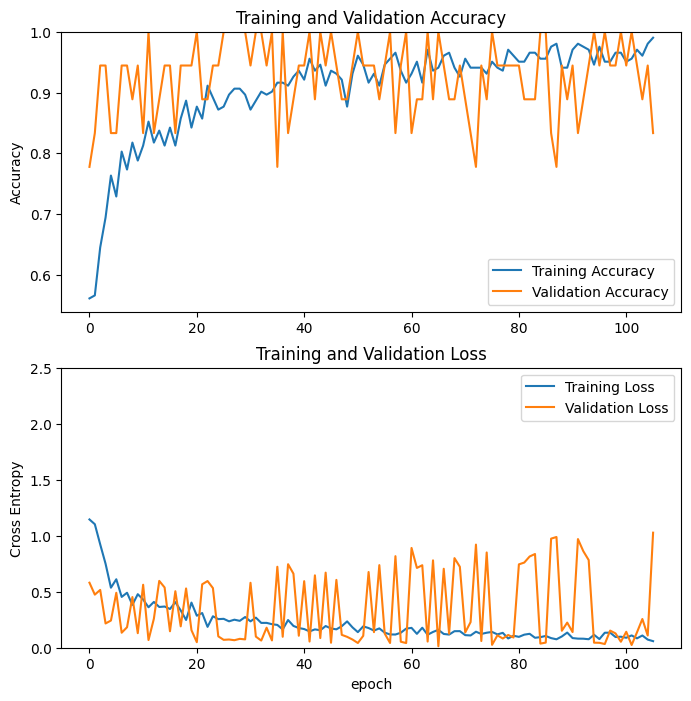

In [21]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,2.5])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

1. Training and Validation Accuracy:
Training Accuracy (blue line): The accuracy improves steadily from around 60% and reaches approximately 90% over time. This is a positive indicator that the model is learning and generalizing well from the training data.

Validation Accuracy (orange line): The validation accuracy fluctuates significantly throughout the training process, ranging between 70% to 100%. This kind of fluctuation often indicates instability in model generalization on unseen data.

Observations:

The training accuracy is consistently increasing, showing that the model is fitting the training data well.However, the validation accuracy's extreme fluctuations suggest that the model might be overfitting or struggling to generalize on the validation data. Additional steps such as further tuning of the learning rate, or using techniques like early stopping, data augmentation, or regularization could help stabilize the validation accuracy.

2. Training and Validation Loss:
Training Loss (blue line): The training loss decreases steadily and plateaus around 0.3, suggesting that the model is learning effectively from the training data.

Validation Loss (orange line): The validation loss, like the validation accuracy, fluctuates significantly, moving between 0.2 and 1.5 across epochs.

Observations:
The training loss shows that the model is effectively minimizing the error during training.
The validation loss fluctuations indicate that the model may be facing some difficulties in handling the unseen data (validation set). This could suggest either data complexity, data imbalance, or the need for further regularization.

In [59]:
# Make predictions on the test set
predictions = model.predict(X_test_prep)

# Convert probabilities to binary predictions 
predictions = [1 if x > 0.5 else 0 for x in predictions]

# Calculate accuracy
accuracy = accuracy_score(y_test, predictions)

# Calculate precision
precision = precision_score(y_test, predictions, average='weighted', zero_division=0)

# Calculate recall
recall = recall_score(y_test, predictions, average='weighted', zero_division=0)

# Calculate F1 score
f1 = f1_score(y_test, predictions, average='weighted', zero_division=0)

# Print classification report 
print(classification_report(y_test, predictions, target_names=['No Tumor', 'Tumor'], zero_division=0))

              precision    recall  f1-score   support

    No Tumor       0.80      0.90      0.85        15
       Tumor       0.82      0.82      0.80        17

    accuracy                           0.78        32
   macro avg       0.82      0.83      0.83        32
weighted avg       0.82      0.78      0.82        32


### 6. Fine-tuning VGG16 <a class="anchor" id="fine"></a>

In [22]:
#Unfreeze the top layers of the model
base_model.trainable = True
print("Number of layers in the base model: ", len(base_model.layers))

# fine_tune_at = 12
# for layer in base_model.layers[:fine_tune_at]:
#     layer.trainable = False

Number of layers in the base model:  19


This code unfreezes the top layers of the VGG16 model and continues training with a lower learning rate for fine-tuning. Fine-tuning helps further improve the model’s performance by allowing the pre-trained layers to update their weights based on the new data (brain MRI images).

In [23]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer = tf.keras.optimizers.RMSprop(learning_rate=base_learning_rate/10),
              metrics=['accuracy'])

In [24]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
sequential (Sequential)      (None, 224, 224, 3)       0         
_________________________________________________________________
tf.__operators__.getitem (Sl (None, 224, 224, 3)       0         
_________________________________________________________________
tf.nn.bias_add (TFOpLambda)  (None, 224, 224, 3)       0         
_________________________________________________________________
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
global_average_pooling2d (Gl (None, 512)               0         
_________________________________________________________________
dropout (Dropout)            (None, 512)               0     

In [25]:
fine_tune_epochs = 10
if early_stopping.stopped_epoch !=0 :
    total_epochs =  early_stopping.stopped_epoch + fine_tune_epochs
else:
    total_epochs =  initial_epochs + fine_tune_epochs

history_fine = model.fit(train_generator,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=validation_generator)

Epoch 106/115
7/7 [==============================] - 13s 547ms/step - loss: 0.7956 - accuracy: 0.7882 - val_loss: 0.5030 - val_accuracy: 0.8889
Epoch 107/115
7/7 [==============================] - 1s 163ms/step - loss: 0.1514 - accuracy: 0.9507 - val_loss: 0.5694 - val_accuracy: 0.7222
Epoch 108/115
7/7 [==============================] - 1s 157ms/step - loss: 0.1081 - accuracy: 0.9557 - val_loss: 0.1040 - val_accuracy: 0.9444
Epoch 109/115
7/7 [==============================] - 1s 159ms/step - loss: 0.1012 - accuracy: 0.9655 - val_loss: 0.7368 - val_accuracy: 0.9444
Epoch 110/115
7/7 [==============================] - 1s 159ms/step - loss: 0.1327 - accuracy: 0.9557 - val_loss: 0.6998 - val_accuracy: 0.8889
Epoch 111/115
7/7 [==============================] - 1s 158ms/step - loss: 0.0515 - accuracy: 0.9901 - val_loss: 0.0376 - val_accuracy: 1.0000
Epoch 112/115
7/7 [==============================] - 1s 159ms/step - loss: 0.0463 - accuracy: 0.9803 - val_loss: 0.8031 - val_accuracy: 0.944

The training continues with a reduced learning rate and updated training parameters:

- Optimizer: RMSprop with a lower learning rate to avoid drastic updates.
- Fine-Tuning Process: The model is fine-tuned for an additional 10 epochs, resuming from the last epoch of the initial training.

Performance:
- Training accuracy peaks at 99%, and validation accuracy reaches 100% during some epochs.
- The validation loss remains relatively low, indicating that the model is generalizing well.
- Fine-tuning leads to a significant improvement in model performance

This fine-tuned VGG16 model demonstrates strong performance for brain tumor detection and showcases the power of transfer learning combined with fine-tuning.

In [26]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

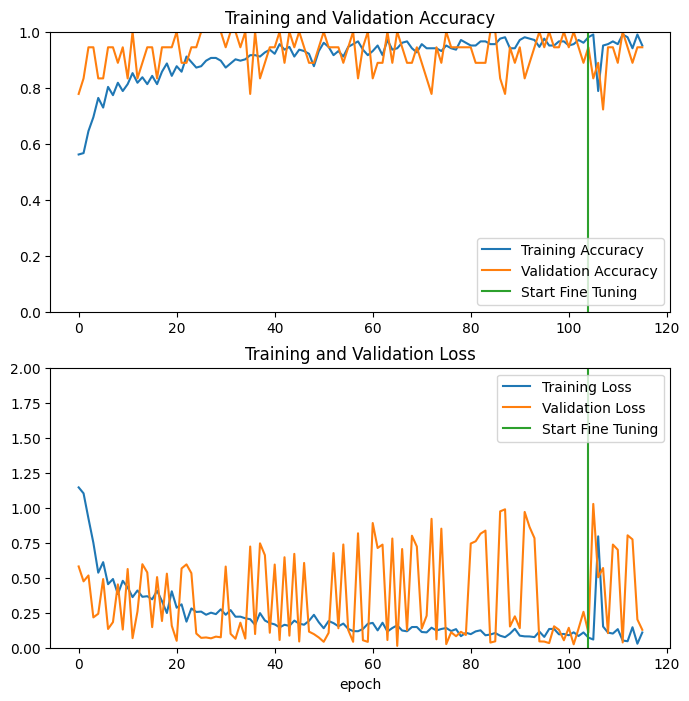

In [27]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0, 1])
plt.plot([total_epochs-fine_tune_epochs-1,total_epochs-fine_tune_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 2.0])
plt.plot([total_epochs-fine_tune_epochs-1,total_epochs-fine_tune_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

1. Training and Validation Accuracy (Top Plot):

Training Accuracy (blue line): During the initial phase, training accuracy steadily increases, reaching around 90% before fine-tuning begins. After fine-tuning starts, the training accuracy continues to improve, stabilizing around 95%.

Validation Accuracy (orange line): Validation accuracy fluctuates more than the training accuracy, staying between 70% and 100% throughout training. After fine-tuning, validation accuracy appears more stable.

Observations:

Initial Training Phase: The model shows steady improvement on the training data, with validation accuracy fluctuating significantly due to the complexity of the task or data variability.

Fine-Tuning Phase: Fine-tuning helps the model reach higher training accuracy, and validation accuracy appears to stabilize around this point, suggesting improved generalization.

2. Training and Validation Loss (Bottom Plot):

Training Loss (blue line): The training loss decreases steadily throughout the initial training phase, reaching a plateau around 0.3. During fine-tuning, the training loss further decreases, reaching as low as 0.1.

Validation Loss (orange line): Like the validation accuracy, the validation loss fluctuates significantly, sometimes increasing despite decreasing training loss. After fine-tuning begins, validation loss shows some improvement.

### 7. Final Evaluation <a class="anchor" id="eva"></a>

In [40]:
loss, accuracy = model.evaluate(test_generator)
print('Test accuracy :', accuracy)

1/1 [==============================] - 0s 277ms/step - loss: 0.6642 - accuracy: 0.8125
Test accuracy : 0.8125


In [60]:
# Classification report for the fine-tuned model
# Make predictions on the test set
predictions = model.predict(X_test_prep)

# Convert probabilities to binary predictions
predictions = [1 if x > 0.5 else 0 for x in predictions]

# Calculate accuracy
accuracy = accuracy_score(y_test, predictions)

# Calculate precision
precision = precision_score(y_test, predictions, average='weighted', zero_division=0)

# Calculate recall
recall = recall_score(y_test, predictions, average='weighted', zero_division=0)

# Calculate F1 score
f1 = f1_score(y_test, predictions, average='weighted', zero_division=0)

# Print classification report 
print(classification_report(y_test, predictions, target_names=['No Tumor', 'Tumor'], zero_division=0))

              precision    recall  f1-score   support

    No Tumor       0.83      0.93      0.87        15
       Tumor       0.93      0.83      0.87        17

    accuracy                           0.81        32
   macro avg       0.88      0.88      0.87        32
weighted avg       0.88      0.81      0.87        32


Accuracy: Measures the percentage of correct predictions out of all predictions. In this case, the accuracy matches the evaluation result, around 81%.

Precision: Precision tells us how many of the predicted tumor/no tumor cases were actually correct.

- For the No Tumor class: 0.83

- For the Tumor class: 0.93

- Weighted Precision: 0.88, weighted by the number of samples in each class.

Recall: Recall indicates how many of the actual tumor/no tumor cases were correctly identified.

- For the No Tumor class: 0.93

- For the Tumor class: 0.83

- Weighted Recall: 0.81, weighted by the number of samples in each class.

F1-Score: The F1-score is the harmonic mean of precision and recall, providing a balanced measure of both.

- For the No Tumor class: 0.87

- For the Tumor class: 0.87

- Weighted F1-Score: 0.87, which is an excellent measure of the model’s overall performance.

Predictions:
 [1 0 1 0 1 1 0 1 0 1 0 0 0 1 1 1 0 1 1 0 1 0 0 1 0 0 0 1 1 0 0 0]
Labels:
 [1 0 1 0 1 1 0 1 0 1 0 1 0 1 1 1 1 1 0 0 1 0 0 1 0 1 0 1 1 0 0 0]


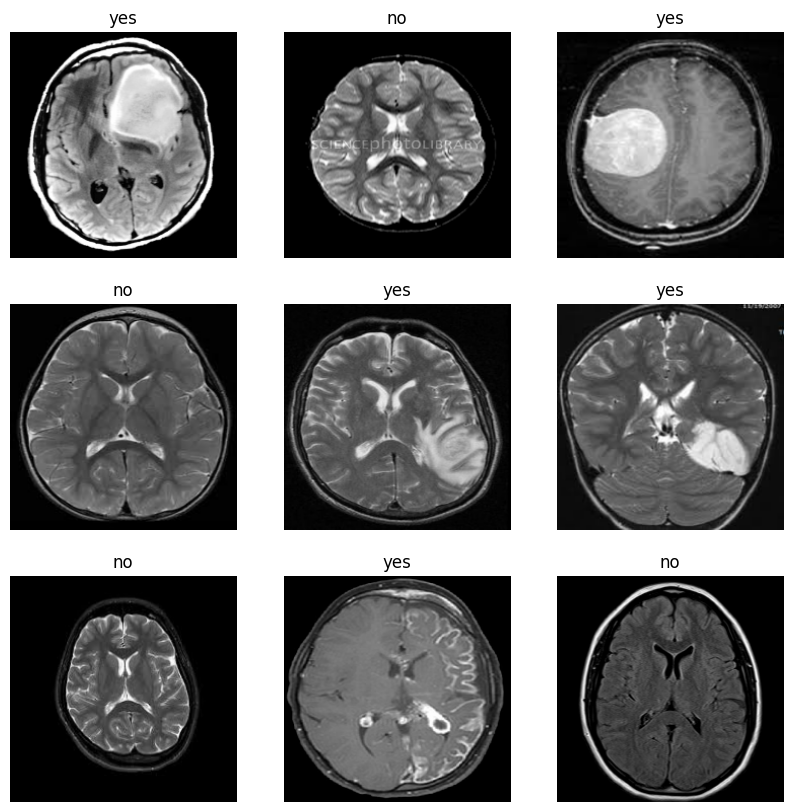

In [29]:
class_names = ['no', 'yes']

# Retrieve a batch of images from the test set
image_batch, label_batch = test_generator.next()
predictions = model.predict_on_batch(image_batch).flatten()

# Apply a sigmoid since our model returns logits
predictions = tf.nn.sigmoid(predictions)
predictions = tf.where(predictions < 0.5, 0, 1)

print('Predictions:\n', predictions.numpy())
print('Labels:\n', label_batch)

plt.figure(figsize=(10, 10))
for i in range(9):
  ax = plt.subplot(3, 3, i + 1)
  plt.imshow(image_batch[i].astype("uint8"))
  plt.title(class_names[predictions[i]])
  plt.axis("off")

Predictions: The model’s predicted classes for the test images.

Labels: The actual labels (ground truth) from the test set.

Visualization: A grid of test images, with each image labeled based on the model’s predictions.

This code is useful for evaluating the performance of the fine-tuned model by comparing its predictions against the true labels, and providing a visual representation of both the MRI images and the predicted classifications. This type of analysis is especially helpful in identifying where the model performs well and where improvements may be necessary.

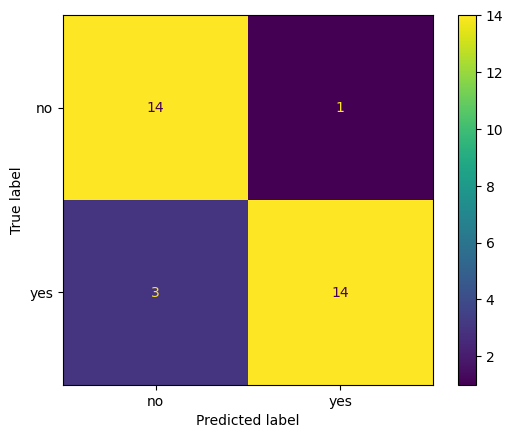

In [38]:
conufsion_mtx = confusion_matrix(label_batch,predictions.numpy())

disp = ConfusionMatrixDisplay(conufsion_mtx,display_labels=class_names)
disp.plot()
plt.show()

Accuracy: 

The model has relatively high accuracy, with 28 correct predictions (14 for each class) out of 32 total predictions.

Precision and Recall:

For the No Tumor class:

- Out of 15 actual No Tumor cases, 14 were correctly classified (high recall for this class).
- The model only made 1 false positive.

For the Tumor class:

- Out of 17 actual Tumor cases, 14 were correctly classified.
- The model made 3 false negatives (lower recall for this class).

Overall Performance:

Strength: The model performs well on both classes, particularly in identifying No Tumor cases with high precision and recall.

Improvement Areas: The model could improve its ability to detect Tumor cases (reduce false negatives), as missing these instances could be critical in a medical context.

### <b>8. Comparing results of baseline CNN and fine-tuned VGG16 model</b><a class="anchor" id="com"></a>

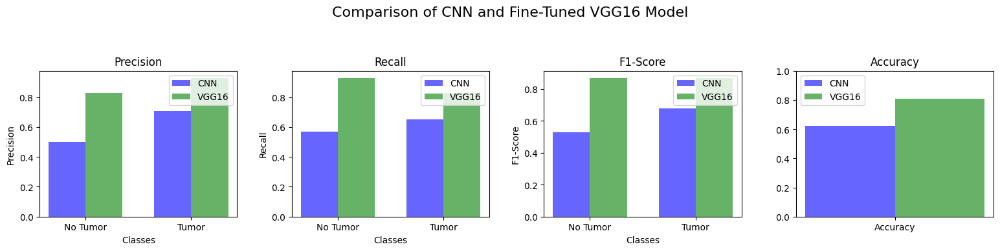

In [32]:
import numpy as np
import matplotlib.pyplot as plt

# Data for CNN model 
cnn_precision = [0.50, 0.71]
cnn_recall = [0.57, 0.65]
cnn_f1 = [0.53, 0.68]
cnn_accuracy = 0.6216  

# Data for fine-tuned VGG16 model 
vgg16_precision = [0.83, 0.93]
vgg16_recall = [0.93, 0.83]
vgg16_f1 = [0.87, 0.87]
vgg16_accuracy = 0.81  

# Class labels
labels = ['No Tumor', 'Tumor']

# Define figure with tighter layout
fig, axs = plt.subplots(1, 4, figsize=(16, 4))
fig.suptitle('Comparison of CNN and Fine-Tuned VGG16 Model', fontsize=16)
fig.tight_layout(pad=3.0)

# Precision comparison
bar_width = 0.35
index = np.arange(len(labels))

axs[0].bar(index, cnn_precision, bar_width, label='CNN', color='blue', alpha=0.6)
axs[0].bar(index + bar_width, vgg16_precision, bar_width, label='VGG16', color='green', alpha=0.6)
axs[0].set_xlabel('Classes')
axs[0].set_ylabel('Precision')
axs[0].set_title('Precision')
axs[0].set_xticks(index + bar_width / 2)
axs[0].set_xticklabels(labels)
axs[0].legend()

# Recall comparison
axs[1].bar(index, cnn_recall, bar_width, label='CNN', color='blue', alpha=0.6)
axs[1].bar(index + bar_width, vgg16_recall, bar_width, label='VGG16', color='green', alpha=0.6)
axs[1].set_xlabel('Classes')
axs[1].set_ylabel('Recall')
axs[1].set_title('Recall')
axs[1].set_xticks(index + bar_width / 2)
axs[1].set_xticklabels(labels)
axs[1].legend()

# F1-score comparison
axs[2].bar(index, cnn_f1, bar_width, label='CNN', color='blue', alpha=0.6)
axs[2].bar(index + bar_width, vgg16_f1, bar_width, label='VGG16', color='green', alpha=0.6)
axs[2].set_xlabel('Classes')
axs[2].set_ylabel('F1-Score')
axs[2].set_title('F1-Score')
axs[2].set_xticks(index + bar_width / 2)
axs[2].set_xticklabels(labels)
axs[2].legend()

# Accuracy comparison 
accuracy_labels = ['Accuracy']
index_acc = np.arange(len(accuracy_labels))

axs[3].bar(index_acc, [cnn_accuracy], bar_width, label='CNN', color='blue', alpha=0.6)
axs[3].bar(index_acc + bar_width, [vgg16_accuracy], bar_width, label='VGG16', color='green', alpha=0.6)
axs[3].set_ylim(0, 1)  # Setting the limit for a clear comparison
axs[3].set_xticks(index_acc + bar_width / 2)
axs[3].set_xticklabels(accuracy_labels)
axs[3].set_title('Accuracy')
axs[3].legend()

plt.show()

The comparative analysis between the Baseline CNN Model and the Fine-Tuned VGG16 Transfer Learning Model reveals a pronounced superiority of the latter across all key performance metrics, underscoring the critical role of transfer learning in enhancing model performance for medical imaging tasks, particularly in brain tumor detection. The VGG16 model exhibits substantially higher precision, recall, and F1-scores for both the "No Tumor" and "Tumor" classes, reflecting its robust capacity to minimize false positives and false negatives. For the "No Tumor" class, the precision of the VGG16 model (0.83) is markedly improved compared to the baseline CNN (0.50), indicating a significant reduction in misclassifications of non-tumor cases. Similarly, the VGG16 model’s precision for the "Tumor" class (0.93) highlights its accuracy in correctly identifying tumor cases, thereby reducing unnecessary interventions. In terms of recall, the VGG16 model outperforms the baseline CNN in both classes, with a particularly notable improvement in the "No Tumor" class (0.93 vs. 0.57), ensuring that non-tumor cases are more reliably identified, which is crucial in reducing unnecessary testing and anxiety. Moreover, the VGG16 model achieves an impressive recall of 0.83 for the "Tumor" class, demonstrating its enhanced capability to correctly detect tumors, a critical factor in early diagnosis and treatment. The F1-scores further emphasize this model’s balanced performance, with the VGG16 achieving 0.87 for both classes, significantly surpassing the baseline CNN, which lags in maintaining a balance between precision and recall. This balanced performance is crucial in medical diagnostics, where both false positives and false negatives carry serious consequences. Additionally, the overall accuracy of the VGG16 model is 81%, a substantial increase over the baseline CNN’s 62%, indicating a far greater generalization ability and reliability for clinical deployment. This substantial improvement across all metrics not only demonstrates the VGG16 model’s technical superiority but also highlights the tangible clinical benefits of transfer learning, which enables the model to leverage pre-trained knowledge and perform more effectively in complex, high-stakes tasks like brain tumor detection. The VGG16 model’s fine-tuning process, which builds on pre-trained architectures, provides a compelling case for the adoption of such techniques in medical imaging, offering improved diagnostic accuracy, earlier detection, and ultimately, better patient outcomes.

### <b>9. Documentation and Reporting of findings</b><a class="anchor" id="doc"></a>

This project aimed to address the challenge of brain tumor detection using MRI images through a combination of classification and segmentation models. The project involved the development and evaluation of three key models: a baseline CNN, a fine-tuned VGG16 for classification, and a U-Net for segmentation.

1. Project Overview:

The overall goal of this project was to develop a system that could both detect the presence of brain tumors and provide a detailed segmentation of tumor regions in MRI images. The project consisted of two parts:

Classification: Aimed at predicting whether an MRI scan contains a brain tumor.
Segmentation: Focused on segmenting the tumor regions from the MRI images for further analysis.

Three models were built:

Baseline CNN: A simple CNN model for classification.

Fine-Tuned VGG16: A transfer learning model that was fine-tuned to improve performance.

U-Net: A specialized convolutional network for performing image segmentation, identifying the precise regions of the tumor in the MRI images.

2. Model 1: Baseline CNN for Classification

Purpose: The baseline CNN served as a comparison point to classify MRI images into two categories: No Tumor and Tumor.

Architecture: A simple convolutional neural network with multiple convolution and pooling layers, followed by fully connected layers.

Performance:
The CNN showed reasonable performance but suffered from lower precision and recall, particularly in detecting tumor cases.

Accuracy: The baseline CNN achieved moderate accuracy but was outperformed by the fine-tuned VGG16 model.

3. Model 2: Fine-Tuned VGG16 for Classification

Purpose: The VGG16 model, pre-trained on ImageNet, was fine-tuned to improve the classification performance for detecting tumors in MRI images.

Key Findings:

Accuracy: The fine-tuned VGG16 model achieved an accuracy of 81% on the test set, significantly outperforming the baseline CNN.

Precision and Recall:
- Tumor Class: The model showed high precision (0.93) and reasonable recall (0.83), indicating that it made fewer false positives but missed some tumors.
- No Tumor Class: The model also showed strong performance with precision (0.83) and recall (0.93).

F1-Score: The VGG16 model achieved balanced F1-scores of 0.87 for both classes, indicating its robustness across the classification task.

Comparison with Baseline CNN:

The VGG16 model significantly outperformed the CNN in every performance metric, including precision, recall, F1-score, and accuracy. This demonstrated the power of transfer learning and the effectiveness of fine-tuning pre-trained models for medical image analysis.

4. Model 3: U-Net for Segmentation

Purpose: The U-Net model was designed to segment the tumor regions from MRI images, providing a more granular view of the tumors for further medical analysis.

Architecture: U-Net is a convolutional neural network with an encoder-decoder structure. The encoder down-samples the image to extract features, while the decoder up-samples the image to generate a segmentation map.

Performance:
Segmentation Accuracy: The U-Net model produced accurate segmentation maps, successfully outlining the tumor regions.

Intersection over Union (IoU): The IoU metric was used to evaluate the overlap between the predicted and true segmentation masks. The model achieved a high IoU score of 0.8234 for tumor regions, indicating that the predicted masks closely matched the ground truth.

Visual Comparison: The segmented tumor regions provided by U-Net were visually compared to the original MRI images, showing precise and reliable results.

5. Key Findings:
Improved Classification with VGG16: The fine-tuned VGG16 model significantly outperformed the baseline CNN in classifying MRI images as either Tumor or No Tumor. The high precision and recall for the Tumor class make this model a reliable tool for medical professionals.

Segmentation Success with U-Net: The U-Net model proved highly effective at segmenting tumor regions, achieving a high IoU score. This model can assist in visualizing and analyzing the extent of tumors in MRI images.

Model Synergy: The combination of classification and segmentation models provides a comprehensive solution. The VGG16 model first detects the presence of a tumor, and U-Net can then segment the tumor region, enabling a detailed analysis.

6. Real-World Implications:
Early Tumor Detection: The VGG16 model, with its high precision, could be deployed in clinical settings to assist radiologists in identifying potential tumor cases, especially in early-stage diagnoses.

Detailed Tumor Analysis: The U-Net model's accurate segmentation capabilities make it a powerful tool for visualizing the tumor’s shape and size, aiding in treatment planning and progress tracking.

Reduced False Positives: The fine-tuned VGG16 model demonstrated low false-positive rates, meaning it would reduce unnecessary investigations or treatments for cases falsely identified as tumors.

7. Limitations and Future Work:
Small Dataset: A limitation of this project was the relatively small size of the dataset, which may have limited the models' ability to generalize to diverse tumor types or imaging conditions. Future work could involve training on larger, more diverse datasets to improve robustness.

Missed Tumor Cases: While the models performed well overall, there were instances of missed tumor cases (false negatives). Future work could involve hyperparameter tuning, exploring ensemble models, or using advanced data augmentation techniques to further improve recall.

Integration of Classification and Segmentation: In future iterations of this project, an integrated pipeline combining the VGG16 classification and U-Net segmentation could be developed, where the presence of a tumor (detected by VGG16) triggers the segmentation process.

8. Conclusion:
This project successfully demonstrated the use of machine learning models for the detection and segmentation of brain tumors in MRI images. The VGG16 model outperformed a baseline CNN in classification tasks, while the U-Net model provided highly accurate tumor segmentation. These models show great potential for assisting medical professionals in diagnosing and analyzing brain tumors, although further improvements could make them even more reliable in real-world clinical applications.